In [2]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

from shapely.geometry import Polygon
from shapely.geometry import Point
from shapely.wkt import loads


In [3]:
df = pd.DataFrame(pd.read_csv("Street_Tree_List-2022-01-30_FILTERED.csv"))

In [4]:
trees = df.copy(deep=True)
trees["PlantDate"] = pd.to_datetime(df["PlantDate"])
trees["PlantDate"][trees["PlantDate"].dt.year >= 2025] -= pd.DateOffset(years=100)

C:\Users\desai\AppData\Local\Temp\ipykernel_12840\3998872196.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  trees["PlantDate"] = pd.to_datetime(df["PlantDate"])
C:\Users\desai\AppData\Local\Temp\ipykernel_12840\3998872196.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trees["PlantDate"][trees["PlantDate"].dt.year >= 2025] -= pd.DateOffset(years=100)


total entries: 37118, missing entries: 27781


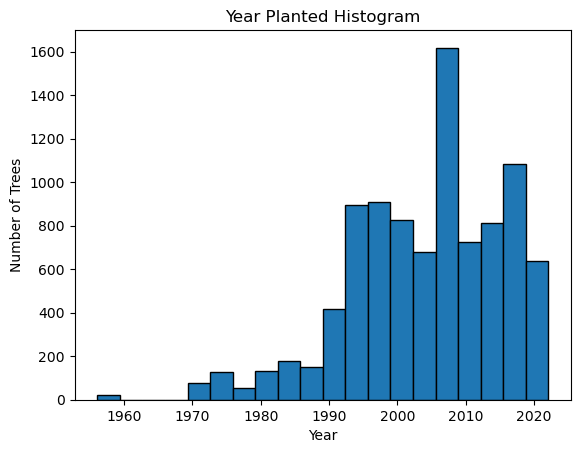

In [5]:
print (f"total entries: {len(trees['PlantDate'])}, missing entries: {trees['PlantDate'].isna().sum()}")
# Plot histogram with custom bins
plt.hist(trees["PlantDate"], bins=20, edgecolor='black')

# Add labels and title
plt.xlabel('Year')
plt.ylabel('Number of Trees')
plt.title('Year Planted Histogram')

# Show the plot
plt.show()

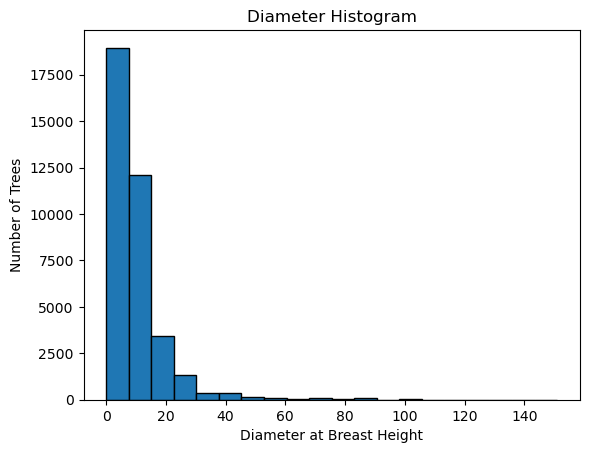

In [6]:
# Plot histogram with custom bins
plt.hist(df['DBH'], bins=20, edgecolor='black')

# Add labels and title
plt.xlabel('Diameter at Breast Height')
plt.ylabel('Number of Trees')
plt.title('Diameter Histogram')

# Show the plot
plt.show()

In [7]:
df = pd.DataFrame(pd.read_csv("2020_CensusTracts_SF.csv", na_values=['(NA)']))
df_reduced = df[['the_geom', 'GEOID', 'NAMELSAD', 'INTPTLAT', 'INTPTLON']]

In [8]:
df_income= pd.DataFrame(pd.read_csv("ACSST5Y2022.S1901-Data.csv"))

#reduce it to key columns
df_income_reduced =df_income[['GEO_ID', 'NAME', 'S1901_C01_012E','S1901_C01_012M', 'S1901_C01_013E', 'S1901_C01_013M']]

#rename and get rid of first row
df_income_reduced = df_income_reduced.rename(columns={"S1901_C01_012E":"est household median income", "S1901_C01_012M":"est household median income margin of error", "S1901_C01_013E":"est household mean income", "S1901_C01_013M":"est household mean income margin of error"}).iloc[1:]

In [9]:
#conversion to numeric
incomes = df_income_reduced.loc[:, ["est household median income", "est household median income margin of error", "est household mean income", "est household mean income margin of error"]].apply(pd.to_numeric, errors='coerce')
ids = df_income_reduced.loc[:, ['GEO_ID', 'NAME']]
df_income_reduced = pd.concat([ids, incomes], axis=1)

#get the census tract part of name
df_income_reduced["NAME"] = df_income_reduced["NAME"].apply(lambda x: x.split(";")[0])

#there are 4 missing values for mean, versus 17 values for median, so I will use mean for analysis
#combine geometry with income data
df_combined = df_reduced.merge(df_income_reduced, left_on="NAMELSAD", right_on="NAME")
df_combined = df_combined.rename(columns={"the_geom":"geometry"})

# Convert WKT strings to Shapely geometries
df_combined['geometry'] = df_combined['geometry'].apply(loads)

# Create a GeoDataFrame
gdf = gpd.GeoDataFrame(df_combined, geometry='geometry', crs="NAD83")

In [12]:
neighborhoods = gpd.read_file("SF-Neighborhoods.geo.json", crs="NAD83").set_crs("NAD83")
neighborhoods= neighborhoods.rename(columns={"name":"neighborhood"})

#this is new
# gdf_combined = pd.merge(neighborhoods, income_by_census_tract, left_on="neighborhood", right_on="neighborhood").drop(columns="id", index=1)

# gdf_joined = gpd.sjoin(gdf_trees, gdf_combined, predicate="within")

In [13]:
#make census tract shapes more precise
joined_neighborhoods = neighborhoods["geometry"].buffer(0).unary_union

outlines =[]
for shape in joined_neighborhoods.geoms:
  outlines.append(Polygon(shape.exterior))

gdf_outlines = gpd.GeoDataFrame(geometry=outlines).set_crs("NAD83")

gdf_combined = gpd.overlay(gdf_outlines, gdf, how="intersection")

In [14]:
trees = pd.DataFrame(pd.read_csv("Street_Tree_List-2022-01-30_FILTERED.csv"))
tree_geoms = [Point(lon, lat) for lon, lat in zip(trees['Longitude'], trees['Latitude'])]
gdf_trees = gpd.GeoDataFrame(trees, geometry=tree_geoms, crs="NAD83")

In [17]:
m = gdf_trees.explore()
gdf_combined.explore(m=m, color="pink")

In [18]:

gdf_joined = gpd.sjoin(gdf_trees, gdf_combined, predicate="within")

In [19]:
tree_counts_by_census_tract = gdf_joined.groupby('NAME').size().reset_index(name='TreeCount')
counties_with_tree_count = pd.merge(gdf_combined, tree_counts_by_census_tract, how='left', left_on='NAME', right_on='NAME')

avgDBH_by_census_tract = gdf_joined.groupby('NAME')["DBH"].median().reset_index(name='AvgDBH')
counties_with_tree_count = pd.merge(counties_with_tree_count, avgDBH_by_census_tract, how='left', left_on='NAME', right_on='NAME')

counties_with_tree_count["area"] = counties_with_tree_count['geometry'].to_crs("EPSG:7131").area
counties_with_tree_count["trees per sqm"] = counties_with_tree_count["TreeCount"] /counties_with_tree_count["area"] 

In [20]:
counties_with_tree_count

,GEOID,NAMELSAD,INTPTLAT,INTPTLON,GEO_ID,NAME,est household median income,est household median income margin of error,est household mean income,est household mean income margin of error,geometry,TreeCount,AvgDBH,area,trees per sqm
0,6075980501,Census Tract 9805.01,37.716208,-122.419346,1400000US06075980501,Census Tract 9805.01,12169.0,1109.0,13664.0,1994.0,"POLYGON ((-122.42719 37.71575, -122.42685 37.7...",26.0,11.0,1.481325e+06,0.000018
1,6075017102,Census Tract 171.02,37.765435,-122.450475,1400000US06075017102,Census Tract 171.02,171205.0,32468.0,251967.0,35853.0,"POLYGON ((-122.45168 37.76845, -122.45052 37.7...",216.0,9.0,2.948984e+05,0.000732
2,6075012302,Census Tract 123.02,37.787022,-122.412097,1400000US06075012302,Census Tract 123.02,43879.0,14641.0,65263.0,7240.0,"POLYGON ((-122.41335 37.78766, -122.41274 37.7...",17.0,5.0,9.265286e+04,0.000183
3,6075016801,Census Tract 168.01,37.771331,-122.429013,1400000US06075016801,Census Tract 168.01,182344.0,48166.0,241170.0,39050.0,"POLYGON ((-122.43082 37.77397, -122.43063 37.7...",139.0,10.0,2.265374e+05,0.000614
4,6075011902,Census Tract 119.02,37.790996,-122.409807,1400000US06075011902,Census Tract 119.02,81995.0,14042.0,109036.0,23662.0,"POLYGON ((-122.41171 37.79172, -122.41110 37.7...",49.0,10.0,9.305489e+04,0.000527
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
236,6075061508,Census Tract 615.08,37.785752,-122.386381,1400000US06075061508,Census Tract 615.08,171915.0,126601.0,297186.0,107721.0,"POLYGON ((-122.38452 37.78739, -122.38435 37.7...",114.0,10.0,2.278037e+05,0.000500
237,6075013001,Census Tract 130.01,37.797663,-122.427228,1400000US06075013001,Census Tract 130.01,191541.0,63973.0,227884.0,50261.0,"POLYGON ((-122.42910 37.79886, -122.42746 37.7...",79.0,9.0,1.814580e+05,0.000435
238,6075010201,Census Tract 102.01,37.801303,-122.421215,1400000US06075010201,Census Tract 102.01,147427.0,34200.0,247393.0,62293.0,"POLYGON ((-122.42465 37.80229, -122.42309 37.8...",128.0,9.0,1.868729e+05,0.000685
239,6075011101,Census Tract 111.01,37.791682,-122.419266,1400000US06075011101,Census Tract 111.01,116897.0,19673.0,169649.0,29548.0,"POLYGON ((-122.42258 37.79219, -122.42105 37.7...",42.0,10.0,1.214131e+05,0.000346


In [ ]:
m = counties_with_tree_count.sort_values(by="TreeCount", ascending=False).iloc[-10:].explore()
counties_with_tree_count.sort_values(by="est household mean income", ascending=False).iloc[-10:].explore(m=m, color = "pink")

In [ ]:
"Census Tract 124.04"

In [ ]:
gdf_joined.columns

Index(['TreeID', 'qLegalStatus', 'qSpecies', 'qAddress', 'SiteOrder',
       'qSiteInfo', 'qCaretaker', 'PlantDate', 'DBH', 'PlotSize', 'Latitude',
       'Longitude', 'geometry', 'index_right', 'GEOID', 'NAMELSAD', 'INTPTLAT',
       'INTPTLON', 'GEO_ID', 'NAME', 'est household median income',
       'est household median income margin of error',
       'est household mean income',
       'est household mean income margin of error'],
      dtype='object')

In [23]:
tree_12404 = gdf_joined.groupby('NAME').get_group("Census Tract 124.04").drop("PlantDate", axis=1)
tract_12404 = counties_with_tree_count[counties_with_tree_count["NAME"] == "Census Tract 124.04"]

tree_133 = gdf_joined.groupby('NAME').get_group("Census Tract 133").drop("PlantDate", axis=1)
tract_133 = counties_with_tree_count[counties_with_tree_count["NAME"] == "Census Tract 133"]

m = tract_12404 .explore()
tree_12404.explore(m=m, color="pink")
tract_133.explore(m=m, color="green")
tree_133.explore(m=m, color="blue")

In [36]:
censustracts_final = counties_with_tree_count.drop(columns=["INTPTLAT", "INTPTLON", "NAMELSAD", "GEOID"], axis=1)
censustracts_final.to_file("tree_by_census_tracts.geojson", driver="GeoJSON")

In [25]:
# tree_12404 = gdf_joined.groupby('NAME').get_group("Census Tract 124.04").drop("PlantDate", axis=1)
# tract_12404 = counties_with_tree_count[counties_with_tree_count["NAME"] == "Census Tract 124.04"]

# tree_133 = gdf_joined.groupby('NAME').get_group("Census Tract 133").drop("PlantDate", axis=1)
# tract_133 = counties_with_tree_count[counties_with_tree_count["NAME"] == "Census Tract 133"]

tree_12404.to_file("tree_12404.geojson", driver="GeoJSON")
tract_12404.to_file("tract_133_12404.geojson", driver="GeoJSON")
tree_133.to_file("tree_133.geojson", driver="GeoJSON")
tract_133.to_file("tract_133.geojson", driver="GeoJSON")

<Axes: >

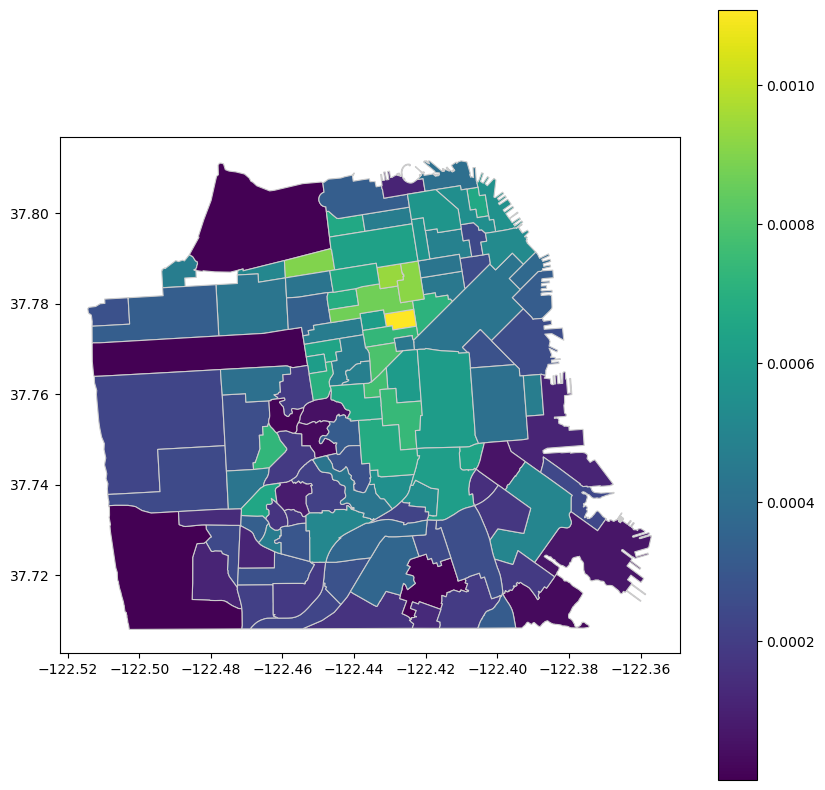

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
counties_with_tree_count.plot(column="trees per sqm", ax=ax, legend=True, cmap='viridis', linewidth=0.8, edgecolor='0.8')

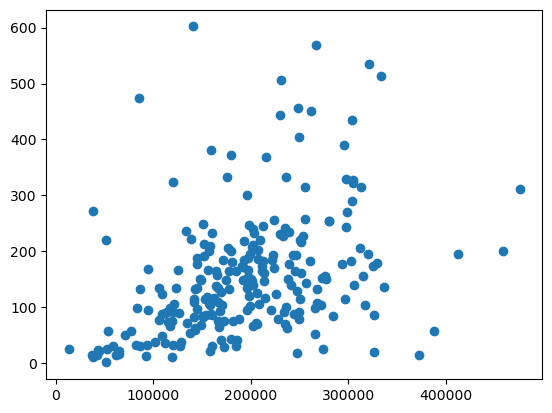

In [ ]:
plt.scatter(counties_with_tree_count["est household mean income"], counties_with_tree_count["TreeCount"])

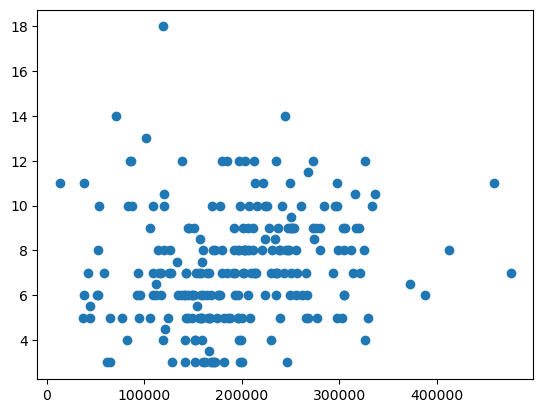

In [ ]:
plt.scatter(counties_with_tree_count["est household mean income"], counties_with_tree_count["AvgDBH"])

In [ ]:
test =counties_with_tree_count[["est household mean income",  "AvgDBH", "trees per sqm", "TreeCount"]]
test.corr()

NameError: name 'counties_with_tree_count' is not defined

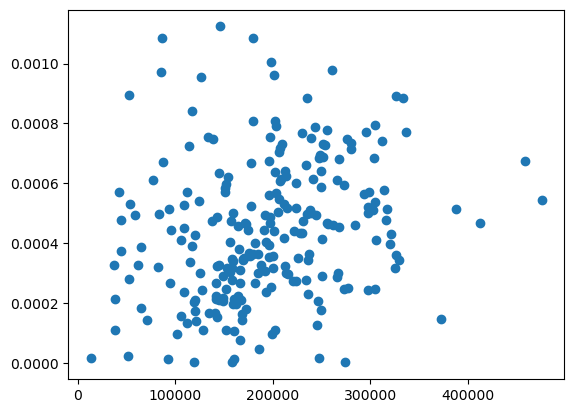

In [ ]:
plt.scatter(counties_with_tree_count["est household mean income"], counties_with_tree_count["trees per sqm"])